# <font size=6.5, color= Brown>Credit Card Approval Prediction Using Machine Learning!</font>

## Context

*Credit score cards are a common risk control method in the financial industry. It uses personal information and data submitted by credit card applicants to predict the probability of future defaults and credit card borrowings. The bank is able to decide whether to issue a credit card to the applicant. Credit scores can objectively quantify the magnitude of risk.
Generally speaking, credit score cards are based on historical data. Once encountering large economic fluctuations. Past models may lose their original predictive power. Logistic model is a common method for credit scoring. Because Logistic is suitable for binary classification tasks and can calculate the coefficients of each feature. In order to facilitate understanding and operation, the score card will multiply the logistic regression coefficient by a certain value (such as 100) and round it.*<br>
 
*At present, with the development of machine learning algorithms. More predictive methods such as Boosting, Random Forest, and Support Vector Machines have been introduced into credit card scoring. However, these methods often do not have good transparency. It may be difficult to provide customers and regulators with a reason for rejection or acceptance.* <br>

## Task

*Build a machine learning model to predict if an applicant is 'good' or 'bad' client, different from other tasks, the definition of 'good' or 'bad' is not given. You should use some techique, such as vintage analysis to construct you label. Also, unbalance data is a big problem in this task.*

### Importing Required Libraries

In [7]:
import pandas as pd
import numpy as np
pd.set_option('display.max_rows', None) 
pd.set_option('display.max_columns', None) #Helps to see all column names in the Dataset
pd.set_option('display.width', None)
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
from plotly.subplots import make_subplots
from pandas_profiling import ProfileReport
import plotly.express as px
import plotly.graph_objects as go
import itertools

%matplotlib inline
%config InlineBackend.figure_format = 'svg'

import warnings
warnings.filterwarnings('ignore')   
from imblearn.over_sampling import SMOTE

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, recall_score, confusion_matrix,f1_score,classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier

### Importing Datasets

* Here, we are extracting the data from two data sources (Datasets). 
* We will be using different methods to understand data
* As data is complex, both dataset need some kind of transformation before analysis
* We will first clean both the datasets individually and then proceed further with respective transformations and feature engineering

In [9]:
#Loading both Datasets
appl_data = pd.read_csv("application_record.csv", encoding = 'utf-8') 
credit_data = pd.read_csv("credit_record.csv", encoding = 'utf-8')

In [10]:
#Removing Whitespaces(Right and Left) from the Column Names of both Datasets
appl_data.columns = appl_data.columns.str.rstrip()
appl_data.columns = appl_data.columns.str.lstrip()
credit_data.columns = credit_data.columns.str.rstrip()
credit_data.columns = credit_data.columns.str.lstrip()

In [11]:
# To check number of records match in both the datasets
len(set(credit_data['ID']).intersection(set(appl_data['ID'])))

36457

###### As per observation, the Common column to both the Datasets is 'ID'. Hence we will be joining both the Datasets on 'ID' column after cleaning them individually.

#### <font size=4>1. 'credit_data'  :  We will be first working on Credit data to get it ready for final analysis.</font>

In [12]:
# To check the Credit Dataset Size
credit_data.shape

(1048575, 3)

In [13]:
# List of Columns in credit_data
credit_data.columns

Index(['ID', 'MONTHS_BALANCE', 'STATUS'], dtype='object')

In [14]:
#To get the first 5 rows of the dataset
credit_data.head()

,ID,MONTHS_BALANCE,STATUS
0,5001711,0,X
1,5001711,-1,0
2,5001711,-2,0
3,5001711,-3,0
4,5001712,0,C


In [15]:
#To get the Bottom 5 rows of the dataset
credit_data.tail()

,ID,MONTHS_BALANCE,STATUS
1048570,5150487,-25,C
1048571,5150487,-26,C
1048572,5150487,-27,C
1048573,5150487,-28,C
1048574,5150487,-29,C


In [16]:
# To get the basic statistics of the data
credit_data.describe()

,ID,MONTHS_BALANCE
count,1.048575e+06,1.048575e+06
mean,5.068286e+06,-1.913700e+01
std,4.615058e+04,1.402350e+01
min,5.001711e+06,-6.000000e+01
25%,5.023644e+06,-2.900000e+01
50%,5.062104e+06,-1.700000e+01
75%,5.113856e+06,-7.000000e+00
max,5.150487e+06,0.000000e+00


In [17]:
# To get a concise summary of the dataframe.
credit_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 3 columns):
 #   Column          Non-Null Count    Dtype 
---  ------          --------------    ----- 
 0   ID              1048575 non-null  int64 
 1   MONTHS_BALANCE  1048575 non-null  int64 
 2   STATUS          1048575 non-null  object
dtypes: int64(2), object(1)
memory usage: 24.0+ MB


In [18]:
# Missing Value Checks
credit_data.isnull().sum()

ID                0
MONTHS_BALANCE    0
STATUS            0
dtype: int64

In [19]:
# To get the Number of Unique Values in all columns
credit_data.nunique() 

#As per observation,'ID' column has lot of duplicate values which has repeating entries for different monthly values and status.

ID                45985
MONTHS_BALANCE       61
STATUS                8
dtype: int64

###### 'STATUS' is our Target Variable. It is categorical type Column which predicts if a client is 'good' or 'bad'.

In [20]:
# To get the the Count of respective categories in the column
credit_data['STATUS'].value_counts()

C    442031
0    383120
X    209230
1     11090
5      1693
2       868
3       320
4       223
Name: STATUS, dtype: int64

In [21]:
# Replacing the value 'C' and 'X' with 0 as it is of same type
credit_data['STATUS']=credit_data['STATUS'].replace(['C','X'],0)

# '1','2','3','4' and '5' are classified as 1 because they are of same type or category
credit_data['STATUS'] = credit_data['STATUS'].astype('int')
credit_data['STATUS'] = credit_data['STATUS'].apply(lambda x:1 if x >= 2 else 0)

#The resultant Column will be our labels/prediction results for our model

In [22]:
round(credit_data['STATUS'].value_counts(normalize=True)*100,3)
# As per observation, the data is oversampled for these labels-'0' is 99% whereas '1' is 1%. 
#Hence, the data is clearly imbalanced.

0    99.704
1     0.296
Name: STATUS, dtype: float64

In [23]:
# Grouping ID column to eliminate duplicates keeping the max value
credit = credit_data.groupby('ID').agg(max).reset_index()
# credit.head()
credit.shape

(45985, 3)

###### <font size=4>2. 'appl_data'  :  Now we will clean Application data to get it ready for final analysis.</font>

In [24]:
# To check the Application Dataset Size
appl_data.shape

(438557, 18)

In [25]:
#List of Columns in appl_data
appl_data.columns

Index(['ID', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN',
       'AMT_INCOME_TOTAL', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'DAYS_BIRTH',
       'DAYS_EMPLOYED', 'FLAG_MOBIL', 'FLAG_WORK_PHONE', 'FLAG_PHONE',
       'FLAG_EMAIL', 'OCCUPATION_TYPE', 'CNT_FAM_MEMBERS'],
      dtype='object')

In [26]:
#To get the first 5 rows of the dataset
appl_data.head()

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
0,5008804,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0
1,5008805,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0
2,5008806,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-21474,-1134,1,0,0,0,Security staff,2.0
3,5008808,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0
4,5008809,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0


In [27]:
#To get the Bottom 5 rows of the dataset
appl_data.tail()

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
438552,6840104,M,N,Y,0,135000.0,Pensioner,Secondary / secondary special,Separated,House / apartment,-22717,365243,1,0,0,0,NaN,1.0
438553,6840222,F,N,N,0,103500.0,Working,Secondary / secondary special,Single / not married,House / apartment,-15939,-3007,1,0,0,0,Laborers,1.0
438554,6841878,F,N,N,0,54000.0,Commercial associate,Higher education,Single / not married,With parents,-8169,-372,1,1,0,0,Sales staff,1.0
438555,6842765,F,N,Y,0,72000.0,Pensioner,Secondary / secondary special,Married,House / apartment,-21673,365243,1,0,0,0,NaN,2.0
438556,6842885,F,N,Y,0,121500.0,Working,Secondary / secondary special,Married,House / apartment,-18858,-1201,1,0,1,0,Sales staff,2.0


In [28]:
# To get the basic statistics of the data
appl_data.describe()

,ID,CNT_CHILDREN,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS
count,4.385570e+05,438557.000000,4.385570e+05,438557.000000,438557.000000,438557.0,438557.000000,438557.000000,438557.000000,438557.000000
mean,6.022176e+06,0.427390,1.875243e+05,-15997.904649,60563.675328,1.0,0.206133,0.287771,0.108207,2.194465
std,5.716370e+05,0.724882,1.100869e+05,4185.030007,138767.799647,0.0,0.404527,0.452724,0.310642,0.897207
min,5.008804e+06,0.000000,2.610000e+04,-25201.000000,-17531.000000,1.0,0.000000,0.000000,0.000000,1.000000
25%,5.609375e+06,0.000000,1.215000e+05,-19483.000000,-3103.000000,1.0,0.000000,0.000000,0.000000,2.000000
50%,6.047745e+06,0.000000,1.607805e+05,-15630.000000,-1467.000000,1.0,0.000000,0.000000,0.000000,2.000000
75%,6.456971e+06,1.000000,2.250000e+05,-12514.000000,-371.000000,1.0,0.000000,1.000000,0.000000,3.000000
max,7.999952e+06,19.000000,6.750000e+06,-7489.000000,365243.000000,1.0,1.000000,1.000000,1.000000,20.000000


In [29]:
# To get a concise summary of the dataframe.
appl_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 438557 entries, 0 to 438556
Data columns (total 18 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   ID                   438557 non-null  int64  
 1   CODE_GENDER          438557 non-null  object 
 2   FLAG_OWN_CAR         438557 non-null  object 
 3   FLAG_OWN_REALTY      438557 non-null  object 
 4   CNT_CHILDREN         438557 non-null  int64  
 5   AMT_INCOME_TOTAL     438557 non-null  float64
 6   NAME_INCOME_TYPE     438557 non-null  object 
 7   NAME_EDUCATION_TYPE  438557 non-null  object 
 8   NAME_FAMILY_STATUS   438557 non-null  object 
 9   NAME_HOUSING_TYPE    438557 non-null  object 
 10  DAYS_BIRTH           438557 non-null  int64  
 11  DAYS_EMPLOYED        438557 non-null  int64  
 12  FLAG_MOBIL           438557 non-null  int64  
 13  FLAG_WORK_PHONE      438557 non-null  int64  
 14  FLAG_PHONE           438557 non-null  int64  
 15  FLAG_EMAIL       

In [30]:
# To get the Number of Unique Values in all columns
appl_data.nunique() 

ID                     438510
CODE_GENDER                 2
FLAG_OWN_CAR                2
FLAG_OWN_REALTY             2
CNT_CHILDREN               12
AMT_INCOME_TOTAL          866
NAME_INCOME_TYPE            5
NAME_EDUCATION_TYPE         5
NAME_FAMILY_STATUS          5
NAME_HOUSING_TYPE           6
DAYS_BIRTH              16379
DAYS_EMPLOYED            9406
FLAG_MOBIL                  1
FLAG_WORK_PHONE             2
FLAG_PHONE                  2
FLAG_EMAIL                  2
OCCUPATION_TYPE            18
CNT_FAM_MEMBERS            13
dtype: int64

In [31]:
# Missing Value Checks
round(100*(appl_data.isnull().sum()/438557),3)

ID                      0.000
CODE_GENDER             0.000
FLAG_OWN_CAR            0.000
FLAG_OWN_REALTY         0.000
CNT_CHILDREN            0.000
AMT_INCOME_TOTAL        0.000
NAME_INCOME_TYPE        0.000
NAME_EDUCATION_TYPE     0.000
NAME_FAMILY_STATUS      0.000
NAME_HOUSING_TYPE       0.000
DAYS_BIRTH              0.000
DAYS_EMPLOYED           0.000
FLAG_MOBIL              0.000
FLAG_WORK_PHONE         0.000
FLAG_PHONE              0.000
FLAG_EMAIL              0.000
OCCUPATION_TYPE        30.601
CNT_FAM_MEMBERS         0.000
dtype: float64

In [32]:
# 'FLAG_MOBIL' has only one value and OCCUPATION_TYPE' has 30% Missing Values. Hence, we will drop both columns
appl_data.drop(['OCCUPATION_TYPE','FLAG_MOBIL'], axis=1, inplace=True)

In [33]:
appl_data.shape

(438557, 16)

In [34]:
# We will drop duplicates from appl_data, keeping the last entry for 'ID' column
appl_data = appl_data.drop_duplicates('ID', keep='last') 

In [36]:
#Lets check for Outliers
fig = make_subplots(rows=1, cols=3)
fig.add_trace(go.Box(
    y=appl_data['CNT_CHILDREN'],
    name="CNT_CHILDREN",
    line_color='rgb(7,40,89)',
),row=1, col=1)
fig.add_trace(go.Box(
    y=appl_data['AMT_INCOME_TOTAL'],
    name="AMT_INCOME_TOTAL",
    marker_color='green',
    line_color='green'
),row=1, col=2)
fig.add_trace(go.Box(
    y=appl_data['CNT_FAM_MEMBERS'],
    name="CNT_FAM_MEMBERS",
    marker_color='goldenrod',
    line_color='goldenrod'
),row=1, col=3)
fig.update_layout(
    title={
        'text': "<b>Boxplots for Outliers Prediction<b>",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        })
fig.show()

In [37]:
Data_outliers=appl_data[["CNT_CHILDREN","AMT_INCOME_TOTAL","CNT_FAM_MEMBERS"]]
Data_outliers.columns.tolist()

for col in Data_outliers.columns:
    percentiles =Data_outliers[col].quantile([0.10,0.90]).values
    Data_outliers[col][Data_outliers[col]<=percentiles[0]] = percentiles[0]
    Data_outliers[col][Data_outliers[col]>=percentiles[1]] = percentiles[1]
    
#Replace the outliers dataset with clean dataset
appl_data.drop(["CNT_CHILDREN","AMT_INCOME_TOTAL","CNT_FAM_MEMBERS"], inplace=True, axis=1)
appl_data=pd.concat([appl_data,Data_outliers],axis=1)
appl_data.head()

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_CHILDREN,AMT_INCOME_TOTAL,CNT_FAM_MEMBERS
0,5008804,M,Y,Y,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,0,0,0,315000.0,2.0
1,5008805,M,Y,Y,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,0,0,0,315000.0,2.0
2,5008806,M,Y,Y,Working,Secondary / secondary special,Married,House / apartment,-21474,-1134,0,0,0,0,112500.0,2.0
3,5008808,F,N,Y,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,0,1,1,0,270000.0,1.0
4,5008809,F,N,Y,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,0,1,1,0,270000.0,1.0


In [38]:
#We have grouped the data in credit_data by ID in order to join with 'appl_data'.
df = appl_data.join(credit.set_index('ID'), on='ID', how='inner')
df.drop(['MONTHS_BALANCE'], axis=1, inplace=True) #Dropping 'MONTHS_BALANCE', as it has less importance
df.shape

(36457, 17)

In [39]:
#To view the Top 5 Rows of the final Data that we have for analysis
df.head()

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_CHILDREN,AMT_INCOME_TOTAL,CNT_FAM_MEMBERS,STATUS
0,5008804,M,Y,Y,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,0,0,0,315000.0,2.0,0
1,5008805,M,Y,Y,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,0,0,0,315000.0,2.0,0
2,5008806,M,Y,Y,Working,Secondary / secondary special,Married,House / apartment,-21474,-1134,0,0,0,0,112500.0,2.0,0
3,5008808,F,N,Y,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,0,1,1,0,270000.0,1.0,0
4,5008809,F,N,Y,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,0,1,1,0,270000.0,1.0,0


In [40]:
#To get the list of Float Type Variables
df.select_dtypes(np.float64).columns

Index(['AMT_INCOME_TOTAL', 'CNT_FAM_MEMBERS'], dtype='object')

In [41]:
#To get the list of Int Type Variables
df.select_dtypes(np.int64).columns

Index(['ID', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'FLAG_WORK_PHONE', 'FLAG_PHONE',
       'FLAG_EMAIL', 'CNT_CHILDREN', 'STATUS'],
      dtype='object')

In [42]:
#To get the list of Object Type Variables
df.select_dtypes(np.object).columns

Index(['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'NAME_INCOME_TYPE',
       'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE'],
      dtype='object')

In [43]:
#To get the Count of Unique Entries in all columns
df.nunique()

ID                     36457
CODE_GENDER                2
FLAG_OWN_CAR               2
FLAG_OWN_REALTY            2
NAME_INCOME_TYPE           5
NAME_EDUCATION_TYPE        5
NAME_FAMILY_STATUS         5
NAME_HOUSING_TYPE          6
DAYS_BIRTH              7183
DAYS_EMPLOYED           3640
FLAG_WORK_PHONE            2
FLAG_PHONE                 2
FLAG_EMAIL                 2
CNT_CHILDREN               3
AMT_INCOME_TOTAL         141
CNT_FAM_MEMBERS            3
STATUS                     2
dtype: int64

### Pandas Profiling Report
###### *Description - Pandas Profiling Report is usually for getting an overview of complete data and various variable characteristics and their relationships*

In [ ]:
#Pandas Profiling Report
profile = ProfileReport(df, title='Pandas Profiling Report for Whole Data', explorative=True) 

#To get overview of complete Data
profile.to_widgets() 

# Save the report as html file
# profile.to_file(output_file=('Pandas_Profiling_Credit_Card_Data.html'))  

###### Lets try Visualizing the data distribution in Target Variable.

In [45]:
df1=df.groupby(['STATUS'],as_index=False)['ID'].count().rename(columns={'ID' : 'Count of Customers'})
df1.sort_values('Count of Customers',ascending=False,inplace=True)
fig=px.bar(df1,'STATUS','Count of Customers')
fig.update_layout(
    title={
        'text': "<b>Count Plot for Target Variable<b>",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        })
fig['layout']['xaxis']['title']='STATUS (Target Variable)'
fig['layout']['yaxis']['title']='Number Of Customers'
fig.show()
# Below Plot clearly shows that the data is Imbalanced in Target Variable

In [50]:
df1=df.groupby(['DAYS_BIRTH', 'DAYS_EMPLOYED', 'AMT_INCOME_TOTAL'],as_index=False)['ID'].count().rename(columns={'ID' : 'Count of Customers'})
df1.sort_values('Count of Customers',ascending=False,inplace=True)
fig = make_subplots(rows=1, cols=3,subplot_titles=('DAYS_BIRTH', 'DAYS_EMPLOYED', 'AMT_INCOME_TOTAL'))
fig.add_trace(go.Scatter(x=df1['DAYS_BIRTH'],y=df1['Count of Customers'],mode='markers'),row=1, col=1)
fig.add_trace(go.Scatter(x=df1['DAYS_EMPLOYED'],y=df1['Count of Customers'],mode='markers'),row=1, col=2)
fig.add_trace(go.Scatter(x=df1['AMT_INCOME_TOTAL'],y=df1['Count of Customers'],mode='markers'),row=1, col=3)
fig.update_layout(height=400, width=1000,autosize = False,showlegend=False,
    title={
        'text': "<b>Scatterplot for some Numerical Variables<b>",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        }),

for x in range(1,4):
#     fig['layout']['xaxis{}'.format(x)]['title']='Variables'
    fig['layout']['yaxis{}'.format(x)]['title']='Number of Customers' 
fig.show()

In [52]:
df1=df.groupby(['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'NAME_INCOME_TYPE','NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE'],
               as_index=False)['ID'].count().rename(columns={'ID' : 'Count of Customers'})
df1.sort_values('Count of Customers',ascending=False,inplace=True)
fig = make_subplots(rows=3, cols=3,subplot_titles=('CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'NAME_INCOME_TYPE','NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
                                                   'NAME_HOUSING_TYPE'))
fig.add_trace(go.Bar(x=df1['CODE_GENDER'],y=df1['Count of Customers']),row=1, col=1)
fig.add_trace(go.Bar(x=df1['FLAG_OWN_CAR'],y=df1['Count of Customers']),row=1, col=2)
fig.add_trace(go.Bar(x=df1['FLAG_OWN_REALTY'],y=df1['Count of Customers']),row=1, col=3)
fig.add_trace(go.Bar(x=df1['NAME_INCOME_TYPE'],y=df1['Count of Customers']),row=2, col=1)
fig.add_trace(go.Bar(x=df1['NAME_EDUCATION_TYPE'],y=df1['Count of Customers']),row=2, col=2)
fig.add_trace(go.Bar(x=df1['NAME_FAMILY_STATUS'],y=df1['Count of Customers']),row=2, col=3)
fig.add_trace(go.Bar(x=df1['NAME_HOUSING_TYPE'],y=df1['Count of Customers']),row=3, col=1)
fig.update_layout(height=1200, width=1000,autosize = False,showlegend=False,
    title={
        'text': "<b>BarPlot for some Categorical Variables<b>",
        'y':1.0,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        }),

for x in range(1,8):
#     fig['layout']['xaxis{}'.format(x)]['title']='Variables'
    fig['layout']['yaxis{}'.format(x)]['title']='Number of Customers' 
fig.show()

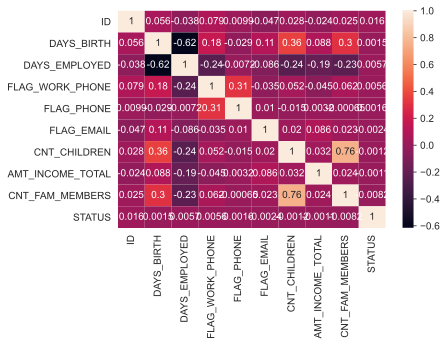

In [53]:
#ploting the heatmap for correlation
ax = sns.heatmap(df.corr(), annot=True)

#### Data Preprocessing

In [54]:
#Converting/Remapping Categorical columns to Integers
df['CODE_GENDER'] = [0 if x == 'M' else 1 for x in df['CODE_GENDER']]
df['FLAG_OWN_CAR'] = [1 if x == 'Y' else 0 for x in df['FLAG_OWN_CAR']]
df['FLAG_OWN_REALTY'] = [1 if x == 'Y' else 0 for x in df['FLAG_OWN_REALTY']]

In [55]:
# Creating Dummy Variables for some columns
dummy_income_type = pd.get_dummies(df['NAME_INCOME_TYPE'], prefix='INC_TYPE', drop_first=True)
dummy_edu_type = pd.get_dummies(df['NAME_EDUCATION_TYPE'], prefix='EDU_TYPE', drop_first=True)
dummy_family_type = pd.get_dummies(df['NAME_FAMILY_STATUS'], prefix='FAM_TYPE', drop_first=True)
dummy_house_type = pd.get_dummies(df['NAME_HOUSING_TYPE'], prefix='HOUSE_TYPE', drop_first=True)

In [56]:
# Drop unnecessary columns
to_drop = ['ID', 'NAME_INCOME_TYPE','NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE']
df.drop(to_drop, axis=1, inplace=True)

In [57]:
# Merge into a single data frame
merged_df = pd.concat([df, dummy_income_type, dummy_edu_type, dummy_family_type, dummy_house_type], axis=1)
merged_df.head()

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_CHILDREN,AMT_INCOME_TOTAL,CNT_FAM_MEMBERS,STATUS,INC_TYPE_Pensioner,INC_TYPE_State servant,INC_TYPE_Student,INC_TYPE_Working,EDU_TYPE_Higher education,EDU_TYPE_Incomplete higher,EDU_TYPE_Lower secondary,EDU_TYPE_Secondary / secondary special,FAM_TYPE_Married,FAM_TYPE_Separated,FAM_TYPE_Single / not married,FAM_TYPE_Widow,HOUSE_TYPE_House / apartment,HOUSE_TYPE_Municipal apartment,HOUSE_TYPE_Office apartment,HOUSE_TYPE_Rented apartment,HOUSE_TYPE_With parents
0,0,1,1,-12005,-4542,1,0,0,0,315000.0,2.0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0
1,0,1,1,-12005,-4542,1,0,0,0,315000.0,2.0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0
2,0,1,1,-21474,-1134,0,0,0,0,112500.0,2.0,0,0,0,0,1,0,0,0,1,1,0,0,0,1,0,0,0,0
3,1,0,1,-19110,-3051,0,1,1,0,270000.0,1.0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0
4,1,0,1,-19110,-3051,0,1,1,0,270000.0,1.0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0


In [58]:
#Separating Input and Target Variables
X = merged_df.drop('STATUS', axis=1) # Input Variables
y = merged_df[['STATUS']] # Target Variable

In [59]:
#Splitting Data into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3)

In [60]:
#Standardizing the Columns for getting accurate results
scaler = StandardScaler()
X_scaled = pd.DataFrame(scaler.fit_transform(X_train), columns=X_train.columns)
X_test_scaled = pd.DataFrame(scaler.transform(X_test), columns=X_test.columns)

In [61]:
#Lets try building model on the data now
# Training Model
model = LogisticRegression()
model.fit(X_scaled, y_train)
preds = model.predict(X_test)

# Evaluate the Results
print(classification_report(y_test, preds))
# print(f'Accuracy = {accuracy_score(y_test, preds):.2f}\nRecall = {recall_score(y_test, preds):.2f}\nF1_score= {f1_score(y_test, preds):.2f}\n')

              precision    recall  f1-score   support

           0       0.98      0.88      0.93     10739
           1       0.02      0.11      0.03       199

    accuracy                           0.87     10938
   macro avg       0.50      0.49      0.48     10938
weighted avg       0.96      0.87      0.91     10938



[[0.88006332 0.11993668]
 [0.89447236 0.10552764]]


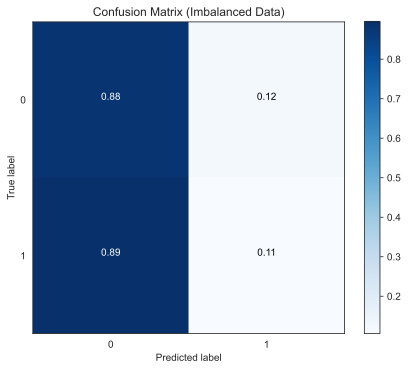

In [62]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        
    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    
plt.figure(figsize=(6, 5))
sns.set_style('white')
class_names=['0','1']
plot_confusion_matrix(confusion_matrix(y_test, preds), classes=class_names,normalize=True,title='Confusion Matrix (Imbalanced Data)')

<b> *As per above results, the Precision, Recall and F1-Score is very low for minority class. Also the confusion matrix clearly shows that there are many misclassified entries in the predictions. Hence, moving forward by treating Imbalanced data using SMOTE.*<b>

In [63]:
# Addressing Oversampling issue for Imbalanced Data
oversample = SMOTE()
X_balanced, y_balanced = oversample.fit_resample(X_scaled, y_train)
X_test_balanced, y_test_balanced = oversample.fit_resample(X_test_scaled, y_test)
print(f'''% Positive class in Train = {np.round(y_train.value_counts(normalize=True)[1] * 100, 2)}
% Positive class in Test  = {np.round(y_test.value_counts(normalize=True)[1] * 100, 2)}
% Positive class in Train after Balancing = {np.round(y_balanced.value_counts(normalize=True)[1] * 100, 2)}
% Positive class in Test after Balancing  = {np.round(y_test_balanced.value_counts(normalize=True)[1] * 100, 2)}''')

% Positive class in Train = STATUS
1         1.63
dtype: float64
% Positive class in Test  = STATUS
1         1.82
dtype: float64
% Positive class in Train after Balancing = STATUS
1         50.0
dtype: float64
% Positive class in Test after Balancing  = STATUS
1         50.0
dtype: float64


In [64]:
# Train Model on balanced data
model = LogisticRegression()
model.fit(X_balanced, y_balanced)
preds = model.predict(X_test_balanced)

# Evaluate the results
print(classification_report(y_test_balanced, preds))

              precision    recall  f1-score   support

           0       0.52      0.59      0.55     10739
           1       0.52      0.46      0.49     10739

    accuracy                           0.52     21478
   macro avg       0.52      0.52      0.52     21478
weighted avg       0.52      0.52      0.52     21478



[[0.58683304 0.41316696]
 [0.54334668 0.45665332]]


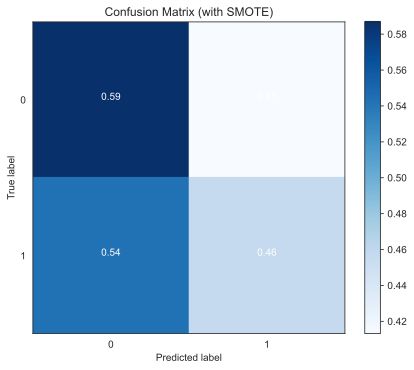

In [65]:
#Confusion Matrix
plt.figure(figsize=(6, 5))
sns.set_style('white')
class_names=['0','1']
plot_confusion_matrix(confusion_matrix(y_test_balanced, preds), classes=class_names,normalize=True,title='Confusion Matrix (with SMOTE)')

<b> *Now the prediction results for minority class have improved. Lets try with other algorithms now.*<b>

In [66]:
#Lets Consider below list of classifiers to check the accuracy results using .score() method (Shorthand calculation of accuracy scores)
classifiers = {
    "LogisticRegression" : LogisticRegression(),
    "KNeighbors" : KNeighborsClassifier(),
    "SVC" : SVC(),
    "DecisionTree" : DecisionTreeClassifier(),
    "RandomForest" : RandomForestClassifier(),
    "LGBM" : LGBMClassifier(),
    "XGBoost" : XGBClassifier(),
    "CatBoost" : CatBoostClassifier(n_estimators = 500, verbose=False)
}

In [67]:
#Lets get the Train and Test Scores for different Classifiers
train_scores = []
test_scores = []

for key, classifier in classifiers.items():
    classifier.fit(X_balanced, y_balanced)
    train_score = classifier.score(X_balanced, y_balanced)
    train_scores.append(train_score)
    test_score = classifier.score(X_test_balanced, y_test_balanced)
    test_scores.append(test_score)

print("Train Scores:",train_scores)
print("Test Scores:",test_scores)

[23:00:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Train Scores: [0.568161899450243, 0.9806788303720819, 0.9025575651342522, 0.9947613735957295, 0.9947613735957295, 0.9838060712293841, 0.9915345390805513, 0.9905186837702176]
Test Scores: [0.5217431790669522, 0.6955023745227675, 0.7275351522488127, 0.8690287736288295, 0.8728931930347332, 0.942732097960704, 0.9509265294720178, 0.9475742620355713]


<b> *As per train and test accuracy scores of the algorithms, XGBoost Classifier is having good results among all. Lets check for its evaluation results.*<b>

In [68]:
# Training and Testing XGBoost Model on balanced data
xgb = XGBClassifier()
model = xgb.fit(X_balanced, y_balanced)
prediction = xgb.predict(X_test_balanced)

# Evaluate the results for predictions
print(classification_report(y_test_balanced, prediction))

[23:00:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
              precision    recall  f1-score   support

           0       0.92      0.99      0.95     10739
           1       0.99      0.91      0.95     10739

    accuracy                           0.95     21478
   macro avg       0.95      0.95      0.95     21478
weighted avg       0.95      0.95      0.95     21478



[[0.99133998 0.00866002]
 [0.08948692 0.91051308]]


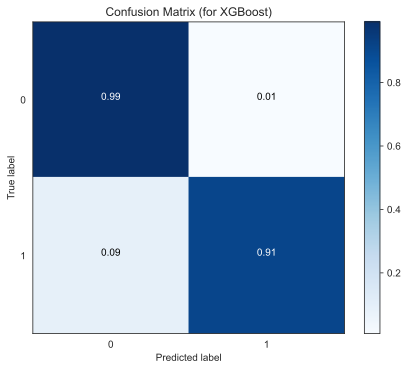

In [69]:
plt.figure(figsize=(6, 5))
sns.set_style('white')
class_names=['0','1']
plot_confusion_matrix(confusion_matrix(y_test_balanced, prediction),classes=class_names,normalize=True,title='Confusion Matrix (for XGBoost)')

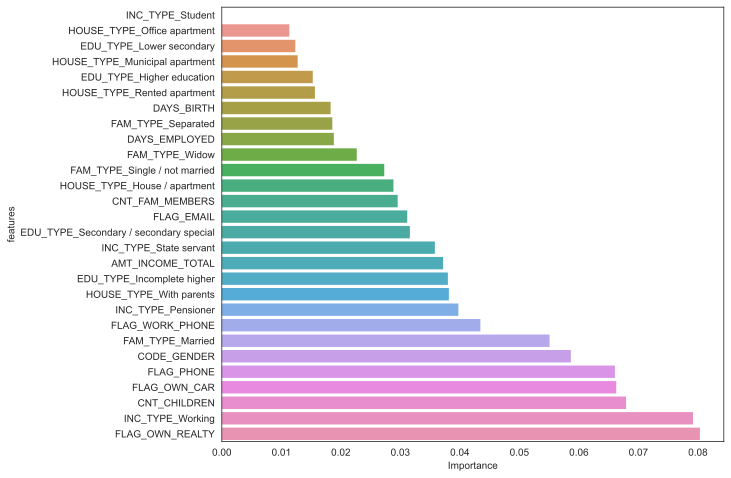

In [70]:
# Feature Importance Graph
def plot_importance(classifer, x_train):
    '''plot feature importance'''
    values = sorted(zip(x_train.columns, classifer.feature_importances_), key = lambda x: x[1] * -1)
    imp = pd.DataFrame(values,columns = ["Name", "Score"])
    imp.sort_values(by = 'Score',inplace = True)
    sns.barplot(x = 'Score',y='Name', linewidth = 0,data = imp,).set(xlabel='Importance', ylabel='features')
plt.figure(figsize=(9, 8))
plot_importance(xgb,X_balanced)

## Conclusion

<b>*1. As per the Classification and Prediction Results we have finalised XGBoost Algorithm.*<br>
*2. The Prediction Results for XGBoost Model are good for both train and test Datasets. Training Accuracy for XGBoost algorithm is 99.13% whereas for Test it is 96.05%.*<br>
*3. After Dealing with Imbalanced data (using SMOTE()), the prediction results improved for Minority (Positive) Class.*<br>
*4. Confusion Matrix demonstrates that 99% of Predicted Negative Values and 93% of Predicted Positive Values are correctly Classified whereas the rest resulted in misclassifications.*<br>
*5. We got good results for Precision, Recall and F1-Score using XGBoost Classifier algorithm for both classes (Refer Classification Report).*<br>
*6. As per Feature Importance Graph Output, 'FLAG_OWN_REALTY', 'INC_TYPE_Working', CODE_GENDER', 'FLAG_OWN_CAR' and 'FLAG_PHONE' are the top 5 attributes that needs to be considered while predicting if a Customer is 'Good' or 'Bad' for Credit Card Approval.*<b>